# Visualization of AOIs and Spectral Bands of Satellite Imagery

In [1]:
import os
import itertools

import numpy as np
import rioxarray as rxr
import earthpy.plot as ep
import geopandas as gpd
import matplotlib.pyplot as plt

![title](../Visualization/AOIMap.png)

Defining AOIs

In [2]:
aoi_list = ['coast_NW', 'coast_N', 'horn', 'coast_W', 'marsh_E', 'marsh_W']
#aoi_list = ['west','east','barrier', 'coast_marsh_S']

def aoi_path(name):
    return '../shapefiles/'+name+'.shp'

### Planet Data GeoTIFFs acquisition

In [3]:
dir = '../Planet/'
#dir = '../Planet_Caracol/'
times = []
sites = []
resSites = []
unmasked_sites = []
for area in aoi_list:
    unmasked_obs = []
    obs = []
    res = []
    aoi = gpd.read_file(aoi_path(area))
    for entry in os.scandir(dir):
        times.append(entry.path)
        ob = rxr.open_rasterio(entry.path).rio.clip(aoi.geometry, from_disk=True).squeeze()
        ob_copy = rxr.open_rasterio(entry.path).rio.clip(aoi.geometry, from_disk=True).squeeze()
        res.append(ob.rio.resolution()[0])
        obs.append(ob)
        unmasked_obs.append(ob_copy)
    sites.append(obs)
    unmasked_sites.append(unmasked_obs)
    resSites.append(res)

## Satellite Imagery Visualization

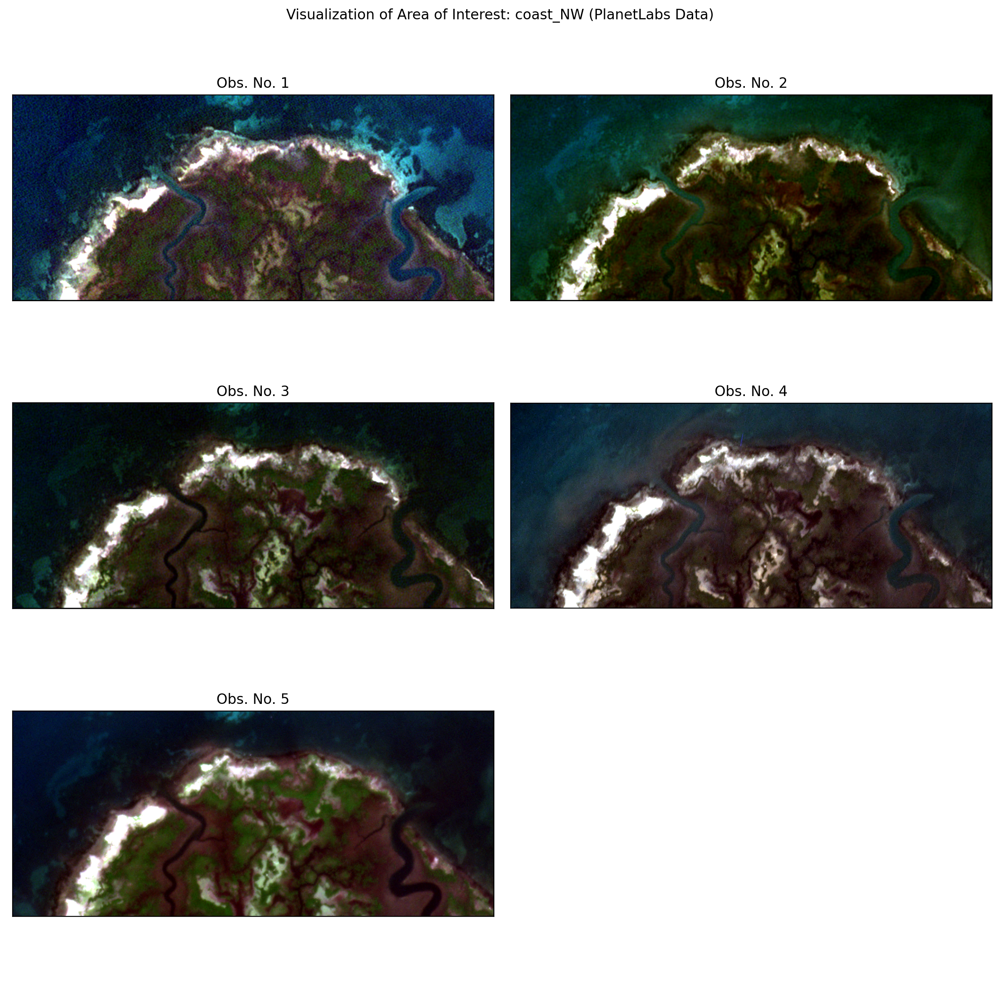

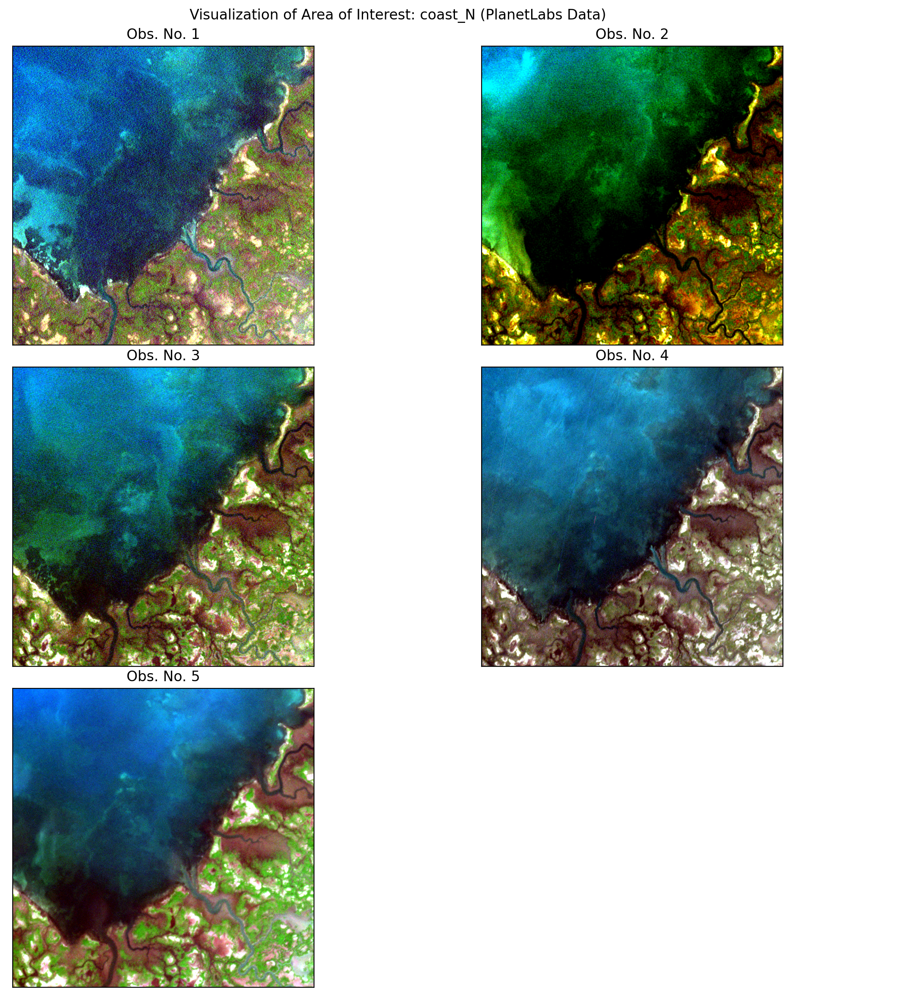

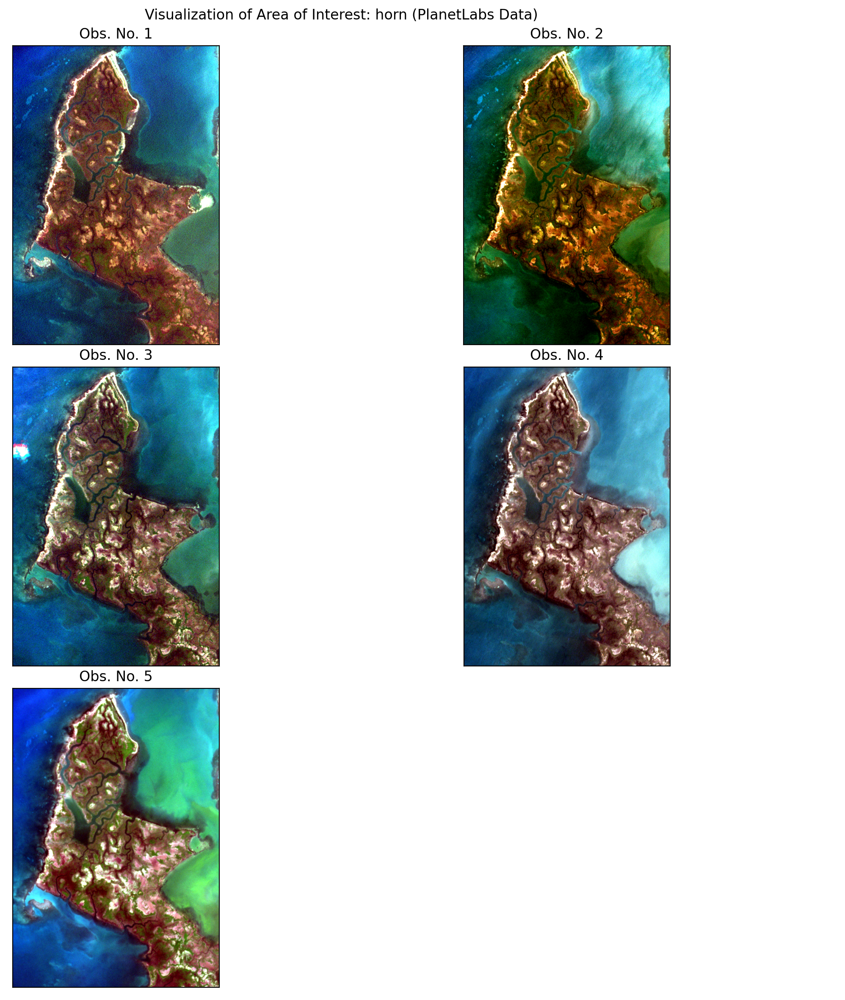

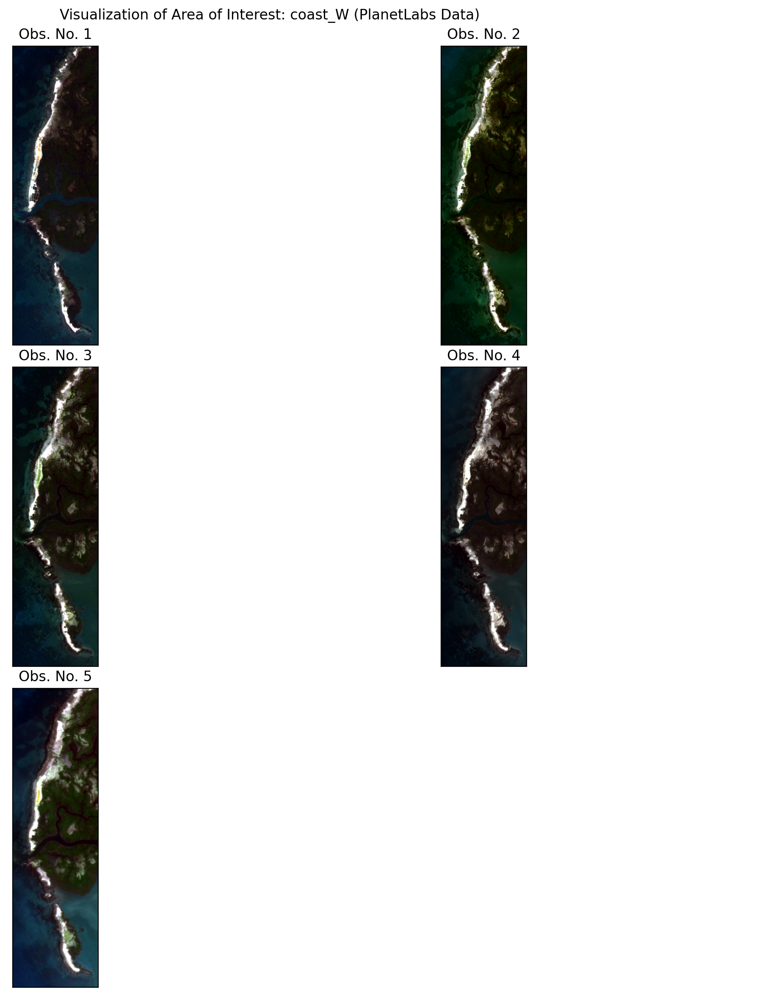

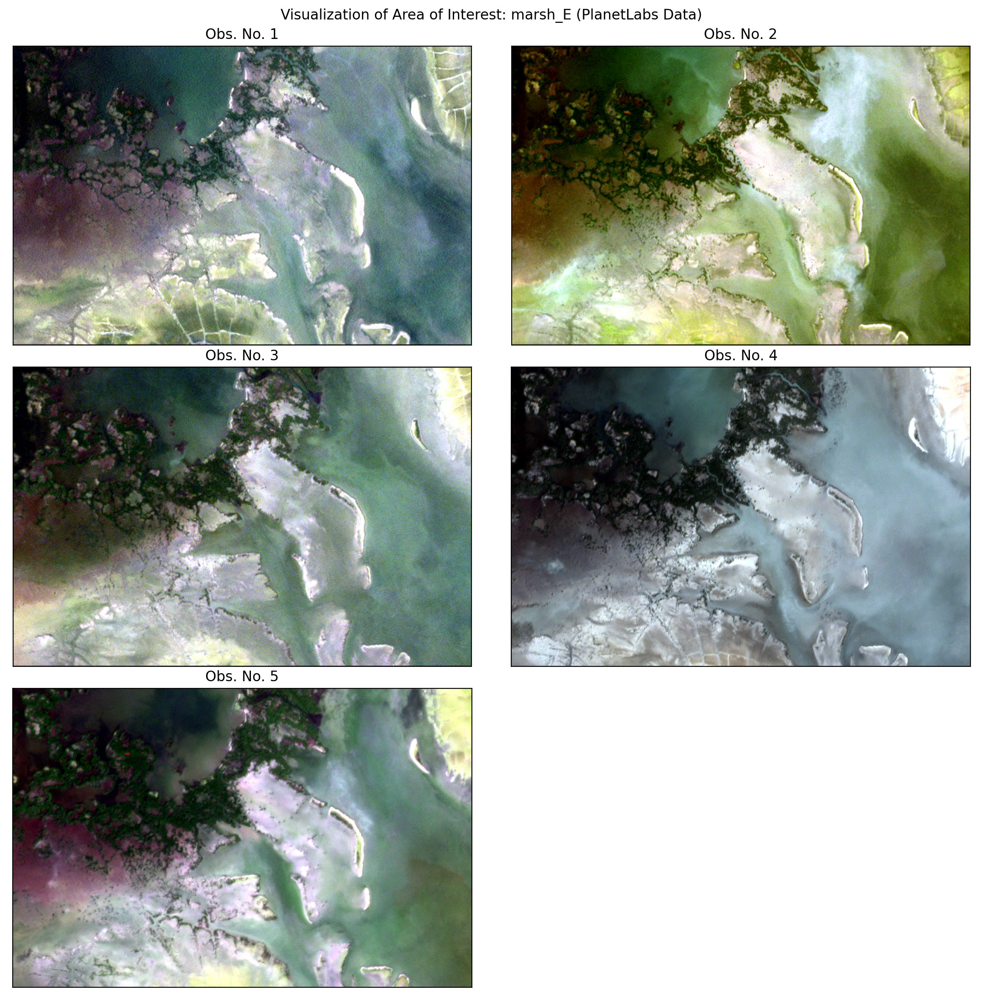

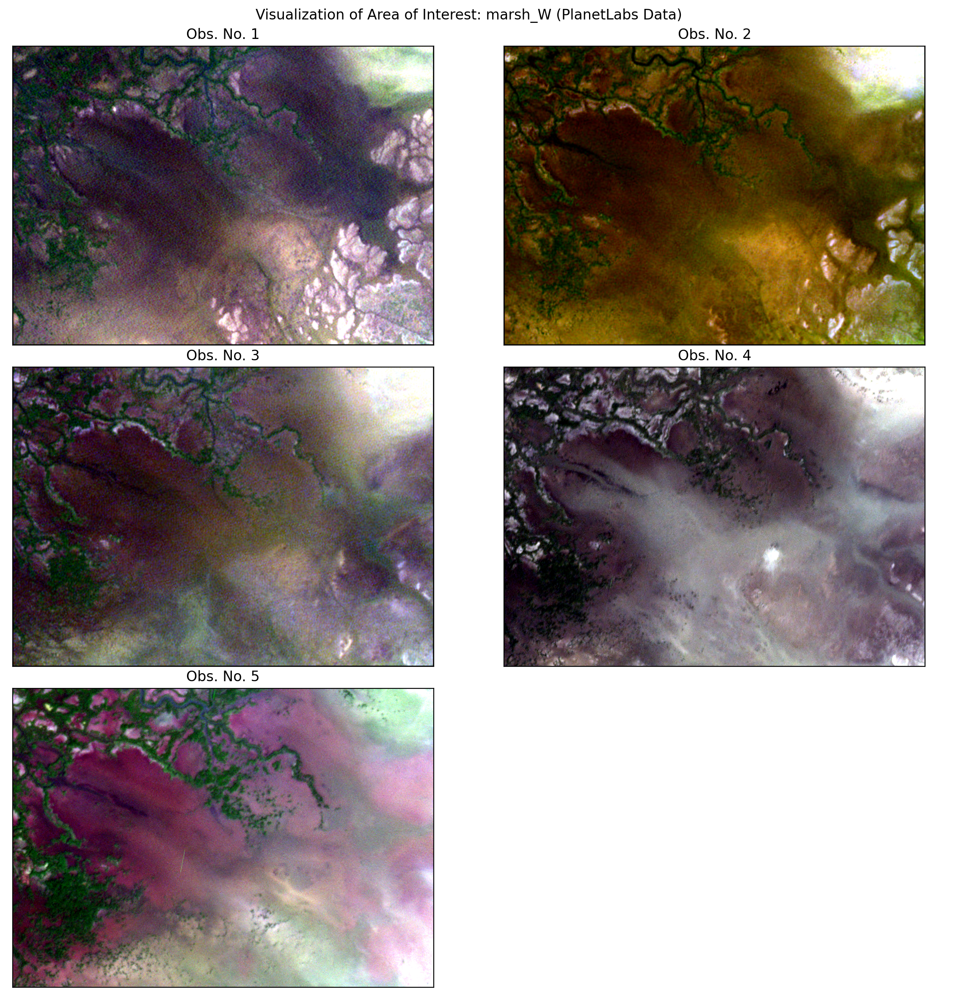

In [4]:
for i, site in enumerate(sites):
    fig, axs = plt.subplots(3,2, figsize=(12,12), dpi=200)
    fig.suptitle(f'Visualization of Area of Interest: {aoi_list[i]} (PlanetLabs Data)')
    axs = list(itertools.chain.from_iterable(axs))
    for j, observation in enumerate(obs):
        ep.plot_rgb(sites[i][j], rgb=[2,1,0], title=f'Obs. No. {j+1}', stretch=True,
                str_clip=1.5, ax=axs[j])
        axs[j].set_xticklabels([])
        axs[j].set_yticklabels([])
    plt.axis('off')
    fig.patch.set_facecolor('xkcd:white')
    plt.tight_layout(h_pad=0)

    plt.show()

## NDWI Masking Visualization

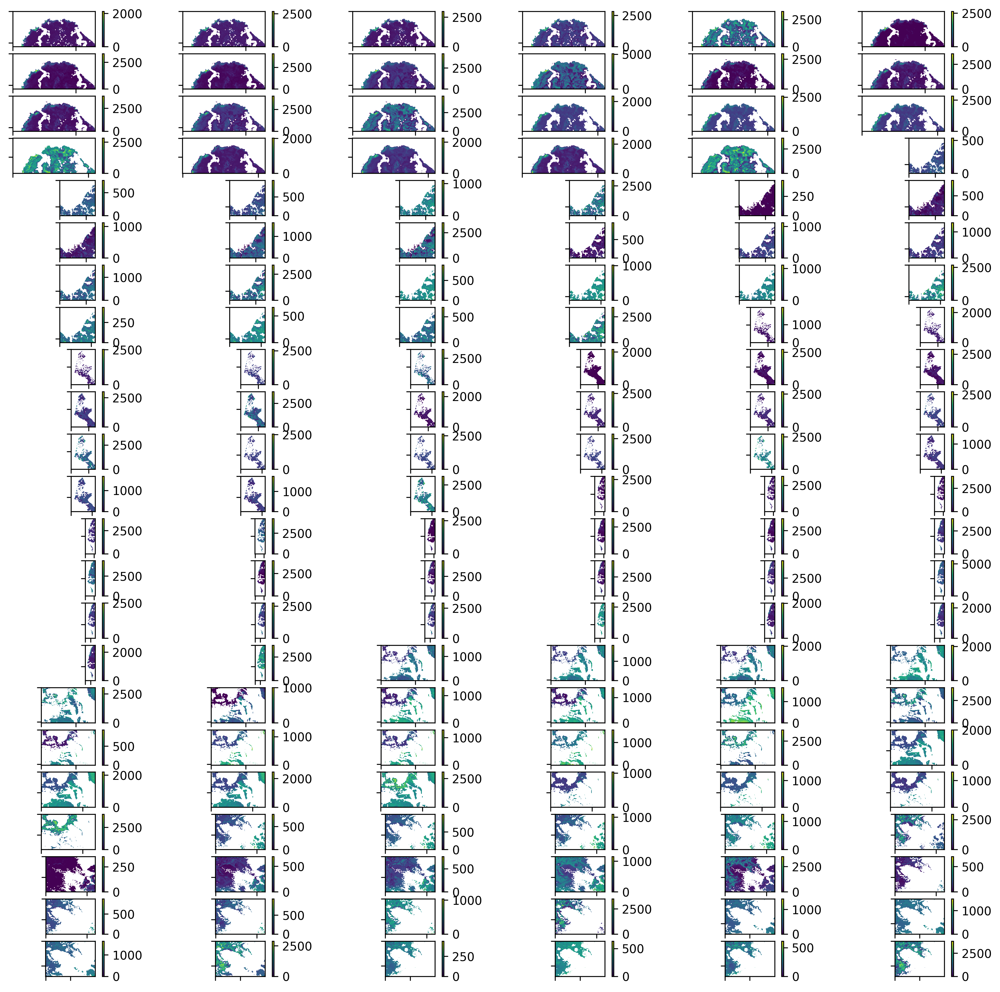

In [5]:
# NDWI = (green - nir)/(green + nir) McFeeters (1996)

fig, axs = plt.subplots(23, 6, figsize=(15,15), dpi=300)
axs = list(itertools.chain.from_iterable(axs))

#NDWI masks
ndwi_masks = []
for site in sites:
    for obs in site:
        try:
            ndwi = (obs[1]-obs[4])/(obs[1]+obs[4])
        except:
            ndwi = (obs[1]-obs[3])/(obs[1]+obs[3])
        ndwi_masks.append(ndwi)

# Masking water out of observations
count = 0
mask_count = 0
for site in sites:
    for i,obs in enumerate(site):
        for j,band in enumerate(obs):
            ### NDWI Masking Interpretation
            band = np.ma.masked_where(ndwi_masks[mask_count] > 0, band)
            obs[j] = np.nan_to_num(band)
            ###
            nd = axs[count].imshow(obs[j])
            axs[count].set_xticklabels([])
            axs[count].set_yticklabels([])
            plt.colorbar(nd, ax = axs[count])
            count+=1
            #obs[j] = np.nan_to_num(band)        
        mask_count+=1    